# Basic Technical Analysis Part 1
## Introduction
This information sets out to detail a wide selection of components used in the technical analysis of options. With this there is an explanation of what each component is and how it is used.

In this first part, there is a brief overview of how basic statistical and computational analysis of stock share price can be computed using python. For visualisations I have chosen to plot using the python library plotly (for interaction purposes) but I have also included matplotlib and seaborn as standards. 


# 1. Import Libraries

In [1]:
import yfinance as yf
import pandas as pd
import numpy as np

import datetime
from datetime import date, timedelta

import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.style as style
from matplotlib.dates import date2num, DateFormatter, WeekdayLocator,\
    DayLocator, MONDAY
import matplotlib.patches as mpatches

import plotly.express as px
import plotly.subplots as sp
import plotly.graph_objects as go

import seaborn as sns

import mplfinance as mpf
from mplfinance.original_flavor import candlestick_ohlc

from scipy import stats
from scipy.stats import zscore
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.stattools import coint

import warnings
warnings.filterwarnings('ignore')

import yfinance as yf

%matplotlib inline

# 2. Dow Jones Index Analysis
## 2.1 Obtaining all Dow Jones Index Tickers

Get all the tickers from the table in this Wikepedia Page
(https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average)


In [2]:
df_dow_jones = pd.read_html("https://en.wikipedia.org/wiki/Dow_Jones_Industrial_Average")[1]
df_dow_jones

,Company,Exchange,Symbol,Industry,Date added,Notes,Index weighting
0,3M,NYSE,MMM,Conglomerate,1976-08-09,As Minnesota Mining and Manufacturing,2.41%
1,American Express,NYSE,AXP,Financial services,1982-08-30,NaN,3.02%
2,Amgen,NASDAQ,AMGN,Biopharmaceutical,2020-08-31,NaN,5.48%
3,Apple,NASDAQ,AAPL,Information technology,2015-03-19,NaN,2.84%
4,Boeing,NYSE,BA,Aerospace and defense,1987-03-12,NaN,3.36%
5,Caterpillar,NYSE,CAT,Construction and mining,1991-05-06,NaN,4.52%
6,Chevron,NYSE,CVX,Petroleum industry,2008-02-19,Also 1930-07-18 to 1999-11-01,3.50%
7,Cisco,NASDAQ,CSCO,Information technology,2009-06-08,NaN,0.96%
8,Coca-Cola,NYSE,KO,Drink industry,1987-03-12,Also 1932-05-26 to 1935-11-20,1.22%
9,Disney,NYSE,DIS,Broadcasting and entertainment,1991-05-06,NaN,1.89%


In [3]:
tickers = df_dow_jones['Symbol'].tolist()
tickers


['MMM',
 'AXP',
 'AMGN',
 'AAPL',
 'BA',
 'CAT',
 'CVX',
 'CSCO',
 'KO',
 'DIS',
 'DOW',
 'GS',
 'HD',
 'HON',
 'IBM',
 'INTC',
 'JNJ',
 'JPM',
 'MCD',
 'MRK',
 'MSFT',
 'NKE',
 'PG',
 'CRM',
 'TRV',
 'UNH',
 'VZ',
 'V',
 'WBA',
 'WMT']

In [4]:
dow_jones_stock = yf.download(tickers, start=datetime.datetime(2010,1,1), end=datetime.datetime(2023,1,1), group_by='tickers')
 

[*********************100%***********************]  30 of 30 completed


In [5]:
dow_jones_stock

CRM                                                  \
                  Open        High         Low       Close   Adj Close   
Date                                                                     
2010-01-04   18.652500   18.882500   18.547501   18.705000   18.705000   
2010-01-05   18.612499   18.750000   18.200001   18.625000   18.625000   
2010-01-06   18.687500   18.750000   18.495001   18.592501   18.592501   
2010-01-07   18.629999   18.737499   18.385000   18.510000   18.510000   
2010-01-08   18.517500   18.587500   18.315001   18.537500   18.537500   
...                ...         ...         ...         ...         ...   
2022-12-23  128.729996  129.860001  127.589996  129.440002  129.440002   
2022-12-27  128.559998  131.750000  127.650002  130.660004  130.660004   
2022-12-28  129.710007  131.139999  128.169998  128.470001  128.470001   
2022-12-29  129.699997  132.949997  129.500000  132.539993  132.539993   
2022-12-30  130.610001  132.639999  130.360001  132.589996  132.589996   

                          INTC                                   ...  \
             Volume       Open       High        Low      Close  ...   
Date                                                             ...   
2010-01-04  7906000  20.790001  21.030001  20.730000  20.879999  ...   
2010-01-05  7942400  20.940001  20.990000  20.600000  20.870001  ...   
2010-01-06  5122400  20.809999  20.930000  20.670000  20.799999  ...   
2010-01-07  4840000  20.730000  20.760000  20.340000  20.600000  ...   
2010-01-08  5510400  20.540001  20.889999  20.400000  20.830000  ...   
...             ...        ...        ...        ...        ...  ...   
2022-12-23  5821300  25.920000  26.190001  25.680000  26.090000  ...   
2022-12-27  8300800  25.850000  26.100000  25.650000  25.940001  ...   
2022-12-28  6249800  25.840000  26.120001  25.500000  25.540001  ...   
2022-12-29  7628800  25.770000  26.290001  25.750000  26.209999  ...   
2022-12-30  5630200  25.900000  26.459999  25.799999  26.430000  ...   

                   MCD                                           JNJ  \
                   Low       Close   Adj Close    Volume        Open   
Date                                                                   
2010-01-04   62.310001   62.779999   42.764206   5839300   64.709999   
2010-01-05   62.189999   62.299999   42.437229   7099000   64.580002   
2010-01-06   61.060001   61.450001   41.858234  10551300   63.900002   
2010-01-07   61.110001   61.900002   42.164757   7517700   64.250000   
2010-01-08   61.599998   61.840000   42.123878   6107300   63.919998   
...                ...         ...         ...       ...         ...   
2022-12-23  264.790009  267.570007  263.214172   1269000  176.669998   
2022-12-27  266.600006  266.839996  262.496033   1674700  178.110001   
2022-12-28  265.070007  265.109985  260.794189   1427800  177.759995   
2022-12-29  264.880005  265.929993  261.600830   1393900  177.550003   
2022-12-30  261.399994  263.529999  259.239929   1720100  177.490005   

                                                                      
                  High         Low       Close   Adj Close    Volume  
Date                                                                  
2010-01-04   64.989998   64.410004   64.680000   43.318604   9506200  
2010-01-05   64.620003   63.820000   63.930000   42.816299  10673100  
2010-01-06   64.540001   63.830002   64.449997   43.164577  13171500  
2010-01-07   64.349998   63.740002   63.990002   42.856491  10901600  
2010-01-08   64.260002   63.630001   64.209999   43.003830   7898000  
...                ...         ...         ...         ...       ...  
2022-12-23  177.520004  175.809998  177.479996  173.632370   3683400  
2022-12-27  178.350006  176.990005  177.429993  173.583450   3067300  
2022-12-28  178.449997  176.649994  176.660004  172.830154   2645400  
2022-12-29  178.300003  177.070007  177.559998  173.710648   2828800  
2022-12-30  177.770004  175.399994  176.6

In [6]:
dow_jones_stock.describe()

CRM                                                      \
              Open         High          Low        Close    Adj Close   
count  3272.000000  3272.000000  3272.000000  3272.000000  3272.000000   
mean    103.428258   104.728752   102.008559   103.409431   103.409431   
std      71.278581    72.140033    70.263135    71.204781    71.204781   
min      15.522500    15.625000    15.075000    15.520000    15.520000   
25%      42.346874    42.747500    41.862499    42.396875    42.396875   
50%      76.295002    77.185001    75.704998    76.275002    76.275002   
75%     155.057503   157.427498   152.930000   155.182495   155.182495   
max     310.000000   311.750000   307.250000   309.959991   309.959991   

                            INTC                                         ...  \
             Volume         Open         High          Low        Close  ...   
count  3.272000e+03  3272.000000  3272.000000  3272.000000  3272.000000  ...   
mean   6.910582e+06    36.478172    36.872014    36.090055    36.489242  ...   
std    5.048138e+06    12.911885    13.089277    12.735358    12.911491  ...   
min    1.084700e+06    17.879999    17.920000    17.600000    17.670000  ...   
25%    4.056725e+06    24.650000    24.877500    24.420000    24.647500  ...   
50%    5.549200e+06    34.264999    34.575001    33.960001    34.325001  ...   
75%    8.116575e+06    48.070001    48.764998    47.560001    48.110001  ...   
max    6.456280e+07    68.199997    69.290001    67.309998    68.470001  ...   

               MCD                                                  JNJ  \
               Low        Close    Adj Close        Volume         Open   
count  3272.000000  3272.000000  3272.000000  3.272000e+03  3272.000000   
mean    142.337534   143.383692   124.646340  4.780518e+06   113.385633   
std      59.562059    60.086444    64.355218  2.576876e+06    36.320224   
min      61.060001    61.450001    41.858234  9.632000e+05    57.250000   
25%      94.207499    94.737499    72.550785  3.036650e+06    81.820002   
50%     118.834999   119.494999   100.571770  4.218900e+06   113.639999   
75%     193.242500   194.419994   178.127068  5.806250e+06   140.745003   
max     277.679993   278.399994   272.334076  3.647160e+07   185.100006   

                                                                         
              High          Low        Close    Adj Close        Volume  
count  3272.000000  3272.000000  3272.000000  3272.000000  3.272000e+03  
mean    114.153420   112.590202   113.403875    96.526289  8.603853e+06  
std      36.641198    36.001097    36.322867    39.924845  4.422652e+06  
min      57.439999    56.860001    57.020000    38.832092  2.114900e+06  
25%      82.177498    81.607502    81.997498    61.592157  5.933050e+06  
50%     114.399998   113.119999   113.775002    94.607113  7.674400e+06  
75%     141.822506   139.759998   140.599998   124.345278  1.002225e+07  
max     186.690002   184.179993   186.009995   178.456894  9.844020e+07  

[8 rows x 180 columns]

In [7]:
dow_jones_stock.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 3272 entries, 2010-01-04 to 2022-12-30
Columns: 180 entries, ('CRM', 'Open') to ('JNJ', 'Volume')
dtypes: float64(151), int64(29)
memory usage: 4.5 MB


In [8]:
# The number of rows is an indication of how many trading days are being considered

dow_jones_stock.shape

(3272, 180)

From here on we are only going to conisder the Adjusted Close Price for each company. This is to account for actions such as stock splits and dividends, which gives a reflection with higher accuracy of the true value of the stock. This in turn prevents a clearer more coherent picture of the returns.

In [9]:
adj_close = pd.DataFrame()
for i in tickers:
    adj_close[i] = dow_jones_stock[i]['Adj Close']
    
adj_close

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,55.033234,33.300186,42.146599,6.487534,43.777554,40.732990,45.955883,17.011654,18.645313,27.933924,...,23.522564,13.857422,40.668755,18.705000,35.691944,25.685123,15.677337,19.978874,25.140764,39.871330
2010-01-05,54.688538,33.226952,41.781494,6.498749,45.211365,41.219986,46.281399,16.935862,18.419764,27.864239,...,23.530169,13.912551,40.682079,18.625000,34.846409,25.644400,15.705604,19.749928,24.938543,39.474297
2010-01-06,55.464111,33.764057,41.467506,6.395378,46.582806,41.345203,46.287197,16.825619,18.413229,27.716164,...,23.385765,13.827732,40.489109,18.592501,34.351978,25.896927,15.254004,19.484720,24.749826,39.386078
2010-01-07,55.503872,34.311657,41.087822,6.383555,48.468563,41.512169,46.112835,16.901413,18.367464,27.724874,...,23.142553,13.963442,40.269531,18.510000,34.846409,26.890768,15.163212,19.666054,24.898108,39.408127
2010-01-08,55.895000,34.287132,41.452911,6.425995,48.001015,41.978287,46.194199,16.990978,18.027510,27.768425,...,23.302156,13.935874,40.216293,18.537500,34.796242,26.638231,15.172766,19.720451,24.931818,39.209629
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,115.073792,144.877289,257.084625,131.299820,189.059998,236.272522,172.482590,46.067890,62.360737,88.010002,...,237.112076,115.152924,149.780899,129.440002,186.249527,525.215332,35.781872,204.643112,36.890579,142.136002
2022-12-27,115.150421,144.256470,256.568359,129.477585,189.399994,239.493484,174.650772,46.116402,62.741817,86.370003,...,235.354095,116.450554,151.086151,130.660004,187.232483,525.887573,36.564396,205.100449,36.584988,142.175537
2022-12-28,113.301804,141.911148,254.649399,125.504547,188.380005,235.789886,172.074234,45.670082,62.116455,84.169998,...,232.940567,113.894913,149.133163,128.470001,184.922577,522.388184,36.154503,203.807953,35.887859,139.684174


### Plotting Adjusted Close Price for all stocks

In [10]:
# Assuming 'adj_close' is your Pandas DataFrame
fig = px.line(adj_close, title='Adjusted Close Price for all stocks')
fig.update_xaxes(title='Year')
fig.update_yaxes(title='Adjusted Close Price (dollar)')

# You can adjust the figure size by setting the width and height
fig.update_layout(width=800, height=400)

fig.show()

This plot shows the absolute adjusted close price for each stock. The relative change of a stock price can be of more use when in a trading scenario. This plot shows UNH to have the greatest price. 

### Calculating the minimum and maximum adjusted close price 

In [11]:
adj_close_min_max = adj_close.apply(lambda x: pd.Series([x.min(), x.max()], index=['min', 'max']))
adj_close_min_max

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
min,49.130005,30.069708,35.246288,5.821835,43.777554,35.568459,39.869144,9.529288,16.504202,25.536148,...,17.649080,12.998613,40.056599,15.520000,34.351978,22.803457,13.068332,14.911669,17.909760,35.695938
max,209.277298,193.470078,282.868988,180.190948,430.299988,239.493484,181.433899,60.169132,63.318043,201.910004,...,337.621124,173.653580,158.212952,309.959991,187.232483,547.095398,52.166176,246.838364,73.572891,156.208817


# 2. Data transformation
## 2.1 Consider each stocks' returns since the beginnig of the time frame 

In [12]:
returns_lambda = adj_close.apply(lambda x: x / x[0])
returns_lambda.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2010-01-04,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
2010-01-05,0.993737,0.997801,0.991337,1.001729,1.032752,1.011956,1.007083,0.995545,0.987903,0.997505,...,1.000323,1.003978,1.000328,0.995723,0.976310,0.998414,1.001803,0.988541,0.991956,0.990042
2010-01-06,1.007829,1.013930,0.983887,0.985795,1.064080,1.015030,1.007209,0.989064,0.987553,0.992204,...,0.994184,0.997857,0.995583,0.993986,0.962457,1.008246,0.972997,0.975266,0.984450,0.987830
2010-01-07,1.008552,1.030374,0.974879,0.983973,1.107156,1.019129,1.003415,0.993520,0.985098,0.992516,...,0.983845,1.007651,0.990184,0.989575,0.976310,1.046939,0.967206,0.984342,0.990348,0.988383
2010-01-08,1.015659,1.029638,0.983541,0.990514,1.096475,1.030572,1.005186,0.998785,0.966865,0.994075,...,0.990630,1.005661,0.988874,0.991045,0.974905,1.037107,0.967815,0.987065,0.991689,0.983404


### Plot to show stock returns over the time frame 
This shows how profitable each stock was over a 13 year period

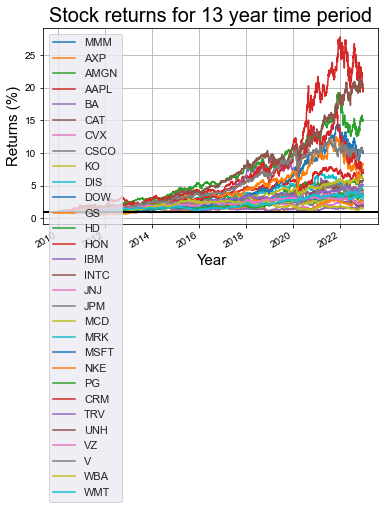

In [13]:
# Plot to show how profitable each stock was throughout the time period

returns_lambda.plot(grid = True).axhline(y = 1, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Stock returns for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Returns (%)', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

This plot is a lot more useful as we can see how profitable each stocj was since the beginning of the time period. 

## 2.2 Percentage Change 
Daily percentage change is another transformation we can use. This can be represented by the formula: $increase_{t}$  = $\frac{price_t - price_{t-1}}{price_t}$ 

In [14]:
# Create dataframe to contain returns for each company's stock to plot the change of each stock per day

returns = pd.DataFrame()
for ticker in tickers:
    returns[ticker] = dow_jones_stock[ticker]['Adj Close'].pct_change() * 100

# Clean up the data by dropping the first value which becomes a 'NaN' as there is no price change from the day before.

returns.dropna(inplace=True)
returns.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.628923,0.947904,0.402882,3.683024,-0.919831,0.789425,0.938337,1.276771,-0.043934,-1.209194,...,2.297486,1.522660,0.756971,2.103848,2.314745,0.606781,1.075097,1.333282,1.290028,0.425805
2019-03-22,-2.361538,-2.110532,-2.704682,-2.070840,-2.825325,-3.200050,-2.200860,-2.224695,0.922895,-0.395726,...,-2.636844,-6.612869,-0.809816,-3.264449,0.394450,-1.956195,2.521856,-1.752193,-1.871071,-0.787405
2019-03-25,-0.708481,-0.383688,-0.058928,-1.209112,2.288969,1.240662,-0.162477,-0.018952,0.217717,-0.406553,...,0.521145,0.170350,0.295082,-0.383898,0.037079,-0.093082,0.535489,-0.026159,-1.153669,-0.111942
2019-03-26,1.983173,0.421853,0.900388,-1.033163,-0.021586,0.350124,1.009032,0.948212,1.325195,2.180170,...,0.212485,1.275304,1.039624,-0.919947,0.022205,-1.405659,0.915447,1.483364,0.372836,0.152799
2019-03-27,-0.038611,-0.474881,-1.035725,0.899417,1.034073,-0.485443,-1.079517,-0.169076,-0.064309,0.127107,...,-0.966853,-0.347783,-0.116461,-2.685068,1.015000,-0.690257,0.412330,-0.695447,0.500646,-1.128972


In [15]:
# Extract the data for the year 2019
returns_2019 = returns.loc['2019-01-01':'2019-12-31']

# Create a line plot using Plotly Express
fig = px.line(returns_2019, x=returns_2019.index, y=returns_2019.columns, title='Stock Returns for 2019')

# Customize the layout
fig.update_layout(
    xaxis_title='Date',
    yaxis_title='Returns (%)',
    title_font=dict(size=20),
    xaxis=dict(title_font=dict(size=15)),
    yaxis=dict(title_font=dict(size=15)),
)

# Add a horizontal line at y=1 for reference
fig.update_layout(
    shapes=[
        dict(
            type="line",
            x0=returns_2019.index.min(),
            x1=returns_2019.index.max(),
            y0=1,
            y1=1,
            line=dict(color="black", width=2)
        )
    ]
)

fig.show()

The percentage returns plot shows the changes for the year 2019 between each day. More advanced methods consider this when modelling stock behaviour on a defined time period.

## 2.3 Log Differences

An alternative approach to modeling stock growth involves utilizing logarithmic differences. By applying the natural logarithm to stock prices, we can more accurately approximate the true daily returns. This concept can be exemplified using the following formula:

$change_{t}$  = $log (price_{t}) - log (price_{t-1})$ 

Employing logarithms or summarizing changes in terms of continuous compounding provides several advantages over analyzing simple percentage changes. For instance, consider a scenario where your investment portfolio increases by 50% (e.g., from £400 to £600) and then decreases by 50% (e.g., from £600 to £300). In this case, calculating the average percentage return (which would be 0%) fails to convey the fact that you actually ended up 50% below your initial investment.

In contrast, if your portfolio increases logarithmically by approximately 0.4055 and then decreases logarithmically by the same amount, you return precisely to your initial investment. The average log return on your portfolio corresponds exactly to the change in log price between the time of purchase and the time of sale, divided by the number of years you held it.

In [16]:
stock_change = adj_close.apply(lambda x: np.log(x) - np.log(x.shift(1))) # shift moves dates back by 1.

stock_change.head()

# Clean up the data by dropping NaNs

stock_change.dropna(inplace=True)
stock_change.head()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,0.006270,0.009434,0.004021,0.036168,-0.009241,0.007863,0.009340,0.012687,-0.000439,-0.012166,...,0.022715,0.015112,0.007541,0.020820,0.022884,0.006049,0.010694,0.013245,0.012818,0.004249
2019-03-22,-0.023899,-0.021331,-0.027419,-0.020926,-0.028660,-0.032524,-0.022254,-0.022498,0.009187,-0.003965,...,-0.026722,-0.068417,-0.008131,-0.033189,0.003937,-0.019756,0.024906,-0.017677,-0.018888,-0.007905
2019-03-25,-0.007110,-0.003844,-0.000589,-0.012165,0.022632,0.012330,-0.001626,-0.000190,0.002175,-0.004074,...,0.005198,0.001702,0.002946,-0.003846,0.000371,-0.000931,0.005341,-0.000262,-0.011604,-0.001120
2019-03-26,0.019638,0.004210,0.008964,-0.010385,-0.000216,0.003495,0.010040,0.009437,0.013165,0.021567,...,0.002123,0.012672,0.010343,-0.009242,0.000222,-0.014156,0.009113,0.014725,0.003721,0.001527
2019-03-27,-0.000386,-0.004760,-0.010411,0.008954,0.010288,-0.004866,-0.010854,-0.001692,-0.000643,0.001270,...,-0.009716,-0.003484,-0.001165,-0.027218,0.010099,-0.006926,0.004115,-0.006979,0.004994,-0.011354


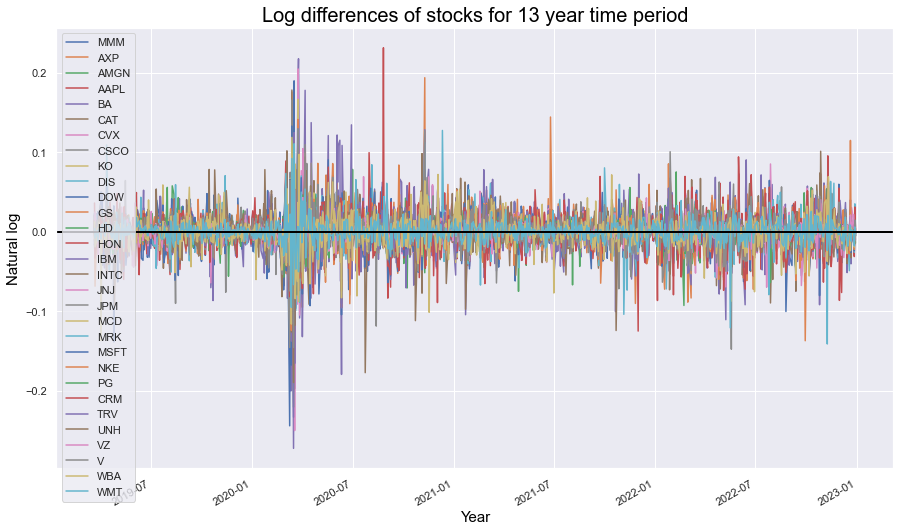

In [17]:
# Plot log differences for 2010-2019

stock_change.plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 13 year time period', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);

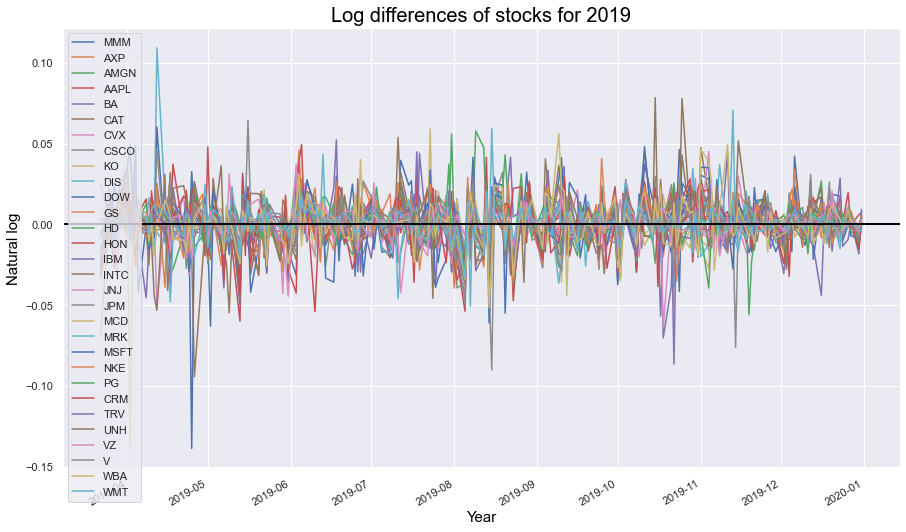

In [18]:
# Plot log differences for 2019

stock_change.loc['2019-01-01':'2019-12-31'][1:].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Log differences of stocks for 2019', color = 'black', fontsize = 20)
plt.xlabel('Year', color = 'black', fontsize = 15)
plt.ylabel('Natural log', color = 'black', fontsize = 15);
plt.legend(loc='upper left')

## 2.4 Annualised Returns
We can calculate the annual percentage rate (APR) by considering annualised returns. 

In [19]:
stock_change_apr = stock_change * 252 * 100    # There are 252 trading days in a year; the 100 converts to percentages
stock_change_apr

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
Date,,,,,,,,,,,,,,,,,,,,,
2019-03-21,157.992358,237.746886,101.322344,911.439008,-232.870123,198.154019,235.358513,319.709748,-11.073698,-306.574120,...,572.415754,380.818442,190.038372,524.669825,576.667102,152.446810,269.478465,333.766961,323.008001,107.074958
2019-03-22,-602.247163,-537.546821,-690.966668,-527.330821,-722.233263,-819.597519,-560.811052,-566.953183,231.502981,-99.920886,...,-673.402554,-1724.099124,-204.904417,-836.367977,99.205887,-497.846691,627.626607,-445.466806,-475.976753,-199.211287
2019-03-25,-179.172584,-96.875246,-14.854205,-306.553318,570.317579,310.723244,-40.977505,-4.776471,54.804960,-102.660232,...,130.987439,42.891592,74.251125,-96.928445,9.342111,-23.467488,134.583176,-6.592879,-292.414602,-28.225305
2019-03-26,494.868726,106.083319,225.882398,-261.711246,-5.440256,88.077249,253.001697,237.823574,331.755772,543.499607,...,53.489503,319.344681,260.632684,-232.899603,5.595064,-356.739173,229.643111,371.062292,93.779853,38.476050
2019-03-27,-9.731806,-119.954978,-262.363742,225.639849,259.248323,-122.629433,-273.517376,-42.643312,-16.210957,32.010687,...,-244.832402,-87.794148,-29.365353,-685.887265,254.490702,-174.547782,103.693408,-175.864917,125.848116,-286.119047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-23,-302.324469,294.820138,-127.627420,-70.611444,108.197344,245.979598,767.281137,85.064197,190.249409,386.635703,...,57.063601,-99.517496,71.099420,48.718260,305.067862,200.952359,65.691497,94.449248,124.254473,50.884052
2022-12-27,16.775533,-108.217492,-50.656395,-352.185974,45.277758,341.216037,314.800664,26.522741,153.526226,-474.013098,...,-187.532195,282.384585,218.651784,236.403349,132.646532,32.233725,545.166385,56.254125,-209.619405,7.008475
2022-12-28,-407.841764,-413.068603,-189.187612,-785.377811,-136.078065,-392.744897,-374.532865,-245.076216,-252.434442,-650.207467,...,-259.757201,-559.201805,-327.866870,-425.958974,-312.828631,-168.247613,-284.091593,-159.307076,-484.820885,-445.498193


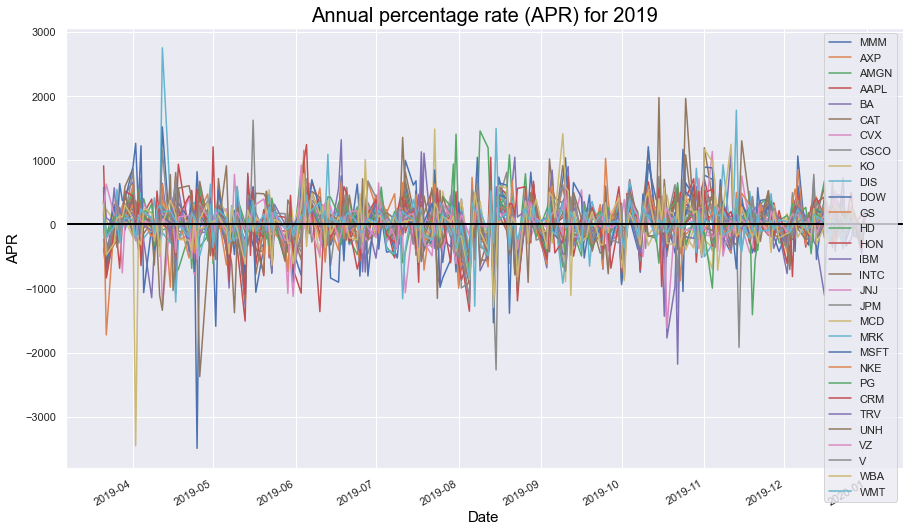

In [20]:
# Plot annualised returns for 2019

stock_change_apr['2019-01-01':'2019-12-31'].plot(grid = True).axhline(y = 0, color = "black", lw = 2)
sns.set(rc={'figure.figsize':(15, 9)})
plt.title('Annual percentage rate (APR) for 2019', color = 'black', fontsize = 20)
plt.xlabel('Date', color = 'black', fontsize = 15)
plt.ylabel('APR', color = 'black', fontsize = 15);

# 3. Calculating Statistical Data for Returns 
## 3.1 Calculating the minimum and maximum returns for 2010-2023

In [21]:
# Date of worst single day returns

returns.idxmin()

MMM    2019-04-25
AXP    2020-03-18
AMGN   2020-03-12
AAPL   2020-03-16
BA     2020-03-16
CAT    2020-03-09
CVX    2020-03-18
CSCO   2022-05-19
KO     2020-03-12
DIS    2022-11-09
DOW    2020-03-09
GS     2020-03-16
HD     2020-03-16
HON    2020-03-12
IBM    2020-03-12
INTC   2020-03-16
JNJ    2020-03-23
JPM    2020-03-16
MCD    2020-03-16
MRK    2021-11-05
MSFT   2020-03-16
NKE    2022-09-30
PG     2020-03-12
CRM    2020-03-16
TRV    2020-03-16
UNH    2020-03-16
VZ     2022-07-22
V      2020-03-16
WBA    2019-04-02
WMT    2022-05-17
dtype: datetime64[ns]

In [22]:
# Date of best single day returns

returns.idxmax()

MMM    2020-03-24
AXP    2020-03-24
AMGN   2020-03-13
AAPL   2020-03-13
BA     2020-03-25
CAT    2020-03-24
CVX    2020-03-24
CSCO   2020-03-13
KO     2020-04-06
DIS    2020-03-24
DOW    2020-03-17
GS     2020-03-13
HD     2020-03-24
HON    2020-03-24
IBM    2020-03-24
INTC   2020-03-13
JNJ    2020-03-30
JPM    2020-03-13
MCD    2020-03-24
MRK    2021-10-01
MSFT   2020-03-13
NKE    2021-06-25
PG     2020-03-13
CRM    2020-08-26
TRV    2020-03-17
UNH    2020-03-24
VZ     2020-03-26
V      2020-03-24
WBA    2020-03-13
WMT    2020-03-17
dtype: datetime64[ns]

There is a common trend amongst the Dow Jones that since they are stocks from the same sector, they have a similarity in there min and max share price. 

## 3.3 Calculating the Mean 
The mean is a statistical indicator that can be used to evaluate the performance f a company's share price over a defined time period. It is the average of the returns, with it also determining the standard deviation and variance which we will touch on later.

In [23]:
returns.mean()

MMM    -0.027745
AXP     0.068697
AMGN    0.058858
AAPL    0.133587
BA     -0.007382
CAT     0.094092
CVX     0.086262
CSCO    0.018697
KO      0.057726
DIS     0.001893
DOW     0.056246
GS      0.092629
HD      0.083617
HON     0.058193
IBM     0.041114
INTC   -0.032310
JNJ     0.045453
JPM     0.062092
MCD     0.058842
MRK     0.060701
MSFT    0.099309
NKE     0.059511
PG      0.061870
CRM     0.010894
TRV     0.065618
UNH     0.104185
VZ     -0.014078
V       0.052936
WBA    -0.014321
WMT     0.055824
dtype: float64

## 3.3 Variance
Variance is a statistical measure that quantifies the extent of deviation from the average or mean in a dataset. It reflects the breadth of the data's range; it is larger when the data covers a wider range and smaller when the range is narrower.

To calculate variance, each data point's difference from the mean is determined, these differences are squared to ensure they are positive, and the sum of these squared differences is divided by the total number of data points in the dataset.

The use of squares in the variance calculation gives more weight to outliers, which are data points that significantly deviate from the mean. This approach also avoids situations where differences above the mean would cancel out differences below it, resulting in a variance value of zero.

Mathematically, variance is represented by the formula σ<sup>2</sup> = $\frac {\sum_{i = 1}^n (x_i - \overline{x})^2}{n}$, where σ<sup>2</sup> denotes the variance, 𝑛 represents the number of data points, 𝑥𝑖 signifies each individual data point, and &xbar; stands for the mean of the dataset.

In [24]:
returns.var()

MMM      3.161755
AXP      6.710330
AMGN     2.797963
AAPL     4.758170
BA      12.281680
CAT      4.470068
CVX      5.964087
CSCO     3.667882
KO       2.083040
DIS      5.095233
DOW      6.750074
GS       4.842344
HD       3.716819
HON      3.445797
IBM      3.209492
INTC     6.141612
JNJ      1.736255
JPM      4.818441
MCD      2.528097
MRK      2.346041
MSFT     4.090281
NKE      4.889821
PG       2.052277
CRM      6.635687
TRV      3.730530
UNH      3.931268
VZ       1.576616
V        3.773200
WBA      4.841844
WMT      2.245823
dtype: float64

## 3.4 Standard Deviation
Standard deviation (represented as σ) plays a crucial role in mathematical statistics and is widely employed beyond its applications in finance. In the realm of statistics, it serves as a fundamental measure of the dispersion or spread of data points within a dataset. This significance extends to various fields, including scientific research, quality control, and data analysis.

Statisticians utilize standard deviation to gain insights into the variability and consistency of data. It assists in identifying patterns, outliers, and trends within a dataset. Moreover, it serves as a key component in hypothesis testing, where it helps assess the degree of confidence in statistical results.

In essence, standard deviation is a versatile statistical tool that transcends its role as a risk measure in finance. It aids in quantifying uncertainty and variability, making it an essential concept in the broader field of mathematical statistics.

In [25]:
returns.std()

MMM     1.778132
AXP     2.590430
AMGN    1.672711
AAPL    2.181323
BA      3.504523
CAT     2.114254
CVX     2.442148
CSCO    1.915172
KO      1.443274
DIS     2.257262
DOW     2.598091
GS      2.200533
HD      1.927905
HON     1.856286
IBM     1.791505
INTC    2.478228
JNJ     1.317670
JPM     2.195095
MCD     1.589999
MRK     1.531679
MSFT    2.022444
NKE     2.211294
PG      1.432577
CRM     2.575983
TRV     1.931458
UNH     1.982743
VZ      1.255634
V       1.942473
WBA     2.200419
WMT     1.498607
dtype: float64

This is only half the picture, however, as, for standard deviation to be used as a measure of risk, we have to assume that the investment performance data follows a normal distribution and has a skewness equal to 0.

## 3.5 Skewness

Financial returns often exhibit either positive or negative skewness, which distorts the appearance of the typically bell-shaped, normally distributed curve. This distortion can impact the accuracy of standard deviation as a risk measure. Skewness, in essence, quantifies the relative magnitude of the two tails of the distribution, shedding light on the distribution's asymmetry.

In [26]:
returns.skew()

MMM    -0.458157
AXP     1.228537
AMGN    0.660653
AAPL    0.035568
BA      0.286379
CAT    -0.252076
CVX    -0.258030
CSCO   -0.434357
KO     -0.578135
DIS     0.461152
DOW    -0.408374
GS      0.202169
HD     -1.104618
HON     0.164603
IBM    -0.550523
INTC   -0.268179
JNJ     0.169707
JPM     0.403120
MCD     0.450678
MRK    -0.155534
MSFT   -0.039000
NKE     0.396942
PG      0.136998
CRM     0.765208
TRV    -1.644742
UNH    -0.055772
VZ      0.066635
V       0.265896
WBA    -0.129856
WMT     0.157127
dtype: float64

This data is not symmetrical as the data falls within a range of -1.7 to 1.25 showing the data is slightly negatively skewed. 

## 3.6 Kurtosis 
Kurtosis is a measure of the combined sizes of the two tails - It does not consider the height of the peak but rather the tail-heaviness of the distribution, or amount of probability in the tails.

In [27]:
returns.kurt()

MMM      8.788539
AXP     16.348909
AMGN     7.174616
AAPL     4.427636
BA      10.535819
CAT      4.191360
CVX     19.939015
CSCO    10.522264
KO       7.381349
DIS      8.227740
DOW     11.988648
GS       9.795382
HD      17.720012
HON     10.158785
IBM      8.738588
INTC    11.417315
JNJ      8.183103
JPM     11.779714
MCD     33.015761
MRK      6.747799
MSFT     7.320544
NKE      8.873868
PG      11.448699
CRM     13.580324
TRV     21.816893
UNH     12.856703
VZ       5.942334
V        8.703901
WBA      5.300397
WMT     13.606191
dtype: float64

A normal distribution will have a kurtosis of 3. However, the pandas kurtosis function makes it a unifrom 0 and so the measures are called excess kurtosis. 

# 4. Visualising Returns
## 4.1 The Pairplot

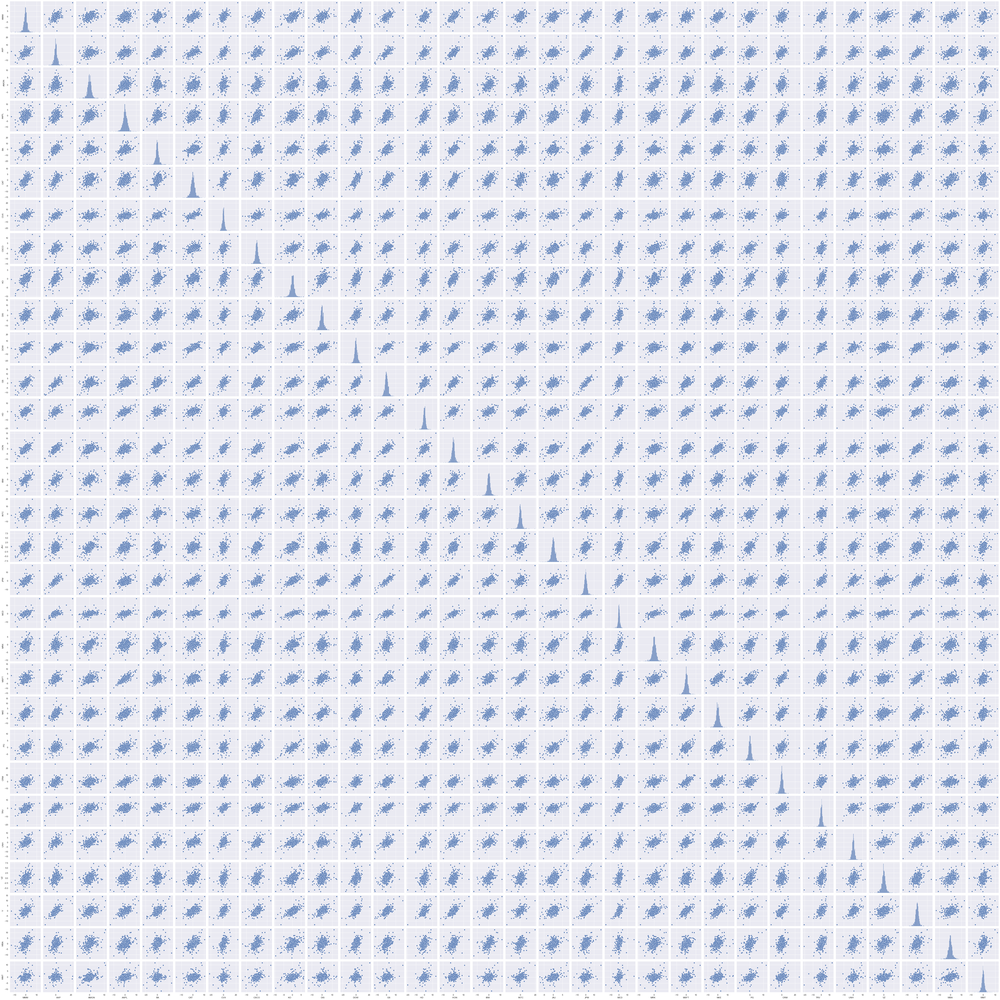

In [28]:
sns.pairplot(returns);

## 4.2 Box Plots
The box and whisker plot is a way of siplaying the distribution of data based on a five criteria (minimum, 1st Quartile (Q1), median, 3rd Quartile (Q3), and maximum). 

In [29]:

# Create a list of box plots for each column in the DataFrame
box_plots = []
for col in returns.columns:
    box_plot = go.Box(y=returns[col], name=col)
    box_plots.append(box_plot)

# Create the layout for the subplot
layout = go.Layout(
    title='Box Plots of Stock Returns',
    xaxis=dict(title='Stocks'),
    yaxis=dict(title='Returns (%)'),
    showlegend=False,
    width=1000,
    height=500
)

# Create the subplot figure
fig = go.Figure(data=box_plots, layout=layout)

# Show the plot
fig.show()

By comparing the differences in the lengths of the boxes (interquartile ranges), we can assess how spread out the data is. When two boxes do not overlap, it indicates distinctions between the two groups being compared. Specifically, we observe that all stocks do not possess this characteristic. 

Additionally, if we analyze the medians of the respective groups and find that one median line lies completely outside of another, it suggests a likely dissimilarity between these two groups. Once again, we can observe that no stocks exhibit distinct characteristics.

The whiskers on the box plot provide insights into the range between the maximum and minimum values, with wider ranges indicating more dispersed or scattered data.

Furthermore, we can use box plots to identify signs of skewness in the data, which may deviate from a normal distribution. Skewed data often result in asymmetric box plots where the median divides the box unevenly. If the longer part of the box lies above the median, we refer to it as positive skewness. Conversely, if the longer part is below or at the median, it signifies negative skewness.

Lastly, any values within the dataset that are significantly different from adjacent values are represented as separate data points on the box plot. This highlights them as potential outliers or extreme observations.

## 4.3 Distribution Plots
Distribution plots depict the variation in the data distribution. Here the distribution of returns is shown by a histogram and a line in combination with it which is the kernel density estimate. 

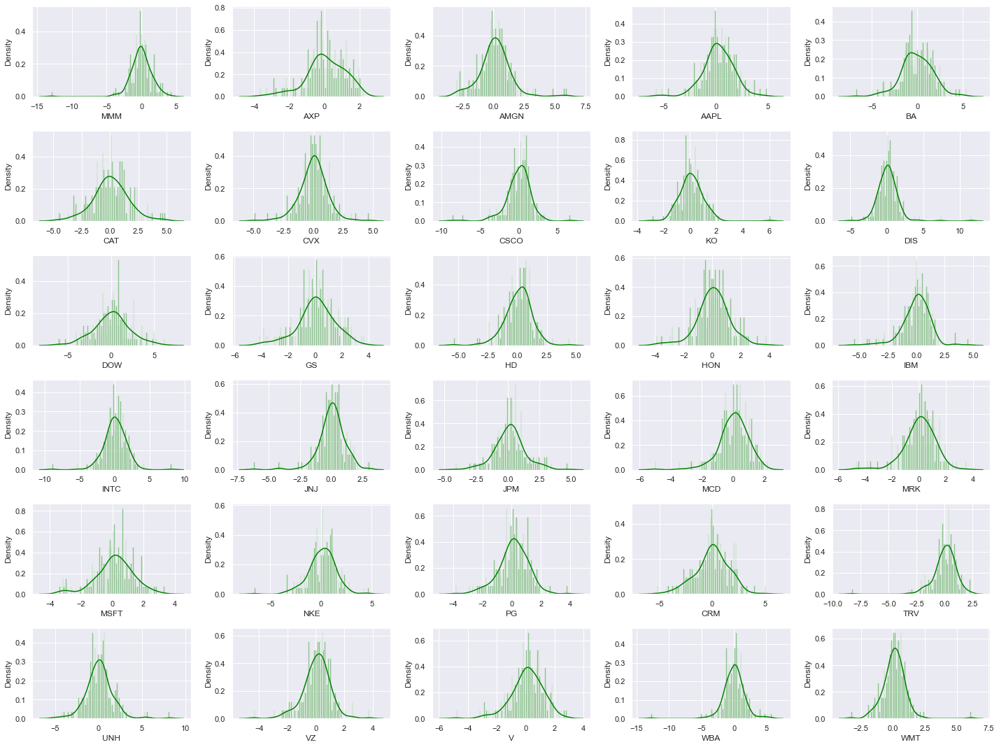

In [30]:
# Create subplots with 5 columns and 6 rows
fig, axs = plt.subplots(ncols=5, nrows=6, figsize=(20, 15))
axs = axs.flatten()

# Loop through tickers and create subplots
for index, ticker in enumerate(tickers):
    if index < len(axs):
        sns.distplot(returns.loc['2019-01-01':'2019-12-31'][ticker], color='green', bins=100, ax=axs[index])

# Remove any remaining empty subplots
for i in range(len(tickers), len(axs)):
    fig.delaxes(axs[i])

# Adjust subplot layout
plt.tight_layout()
plt.show()

## 4.4 Covariance
Covariance reflects the orientation of the linear connection between variables. It quantifies the association between the returns of two stocks, offering insights into whether these returns tend to synchronize or counteract each other.

Investors might also identify stocks that harmonize in terms of price fluctuations. Such a strategy could mitigate overall risk while enhancing the potential return of a portfolio.

In [31]:
returns.cov()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,3.161755,2.513803,1.234331,1.764745,2.519012,2.342081,2.073539,1.863678,1.380712,1.894611,...,1.520800,1.922810,1.153488,1.428487,1.612498,1.567847,0.932941,1.779409,1.999236,0.815483
AXP,2.513803,6.710330,1.544423,2.765933,6.086494,3.442624,4.221940,2.681847,2.204661,3.896950,...,2.701087,3.161503,1.432994,2.748275,3.199211,2.712485,1.259406,3.668398,2.507627,0.904372
AMGN,1.234331,1.544423,2.797963,1.663181,1.268212,1.320505,1.333062,1.524296,1.070479,1.123600,...,1.651198,1.113134,1.240591,1.349573,1.259478,1.702073,0.893803,1.435703,1.421883,0.970936
AAPL,1.764745,2.765933,1.663181,4.758170,3.261922,1.863981,2.003904,2.508209,1.478226,2.398219,...,3.481448,2.722702,1.492127,3.331177,1.595172,2.136206,0.952825,2.657920,1.793959,1.353782
BA,2.519012,6.086494,1.268212,3.261922,12.281680,3.922364,4.810595,2.737566,2.437791,4.345578,...,2.952150,3.668034,1.350439,3.204923,3.361597,2.700575,1.249865,3.574400,2.958112,0.853855
CAT,2.342081,3.442624,1.320505,1.863981,3.922364,4.470068,3.275539,2.042922,1.488800,2.509403,...,1.749600,2.262611,1.028041,1.700425,2.140415,1.766746,1.066842,2.143993,2.330193,0.873643
CVX,2.073539,4.221940,1.333062,2.003904,4.810595,3.275539,5.964087,2.098023,1.709853,2.700665,...,1.992970,2.250091,0.960891,1.962036,2.792854,2.421427,1.136113,2.583971,2.059492,0.787240
CSCO,1.863678,2.681847,1.524296,2.508209,2.737566,2.042922,2.098023,3.667882,1.426114,2.240959,...,2.435267,2.143171,1.490995,2.264153,1.664456,1.864592,1.050268,2.171858,2.002768,1.152161
KO,1.380712,2.204661,1.070479,1.478226,2.437791,1.488800,1.709853,1.426114,2.083040,1.653401,...,1.454291,1.496587,1.357076,1.279509,1.578985,1.487069,0.989530,1.687983,1.375232,0.888183
DIS,1.894611,3.896950,1.123600,2.398219,4.345578,2.509403,2.700665,2.240959,1.653401,5.095233,...,2.422734,2.674707,1.172739,2.587130,1.918140,1.687509,0.935780,2.770745,1.900230,0.918824


## 4.5 Correlation
Correlation gauges both the intensity and orientation of the linear connection between two variables, assessing how closely they move in tandem or opposition to each other. It is derived from covariance and provides a comprehensive measure of the relationship between these variables.

In [32]:
returns.corr()

,MMM,AXP,AMGN,AAPL,BA,CAT,CVX,CSCO,KO,DIS,...,MSFT,NKE,PG,CRM,TRV,UNH,VZ,V,WBA,WMT
MMM,1.000000,0.545752,0.414999,0.454986,0.404238,0.622989,0.477503,0.547267,0.538010,0.472035,...,0.422894,0.489019,0.452826,0.311867,0.469515,0.444706,0.417857,0.515177,0.510969,0.306029
AXP,0.545752,1.000000,0.356429,0.489497,0.670450,0.628580,0.667372,0.540573,0.589686,0.666455,...,0.515573,0.551919,0.386149,0.411856,0.639419,0.528116,0.387196,0.729037,0.439932,0.232963
AMGN,0.414999,0.356429,1.000000,0.455825,0.216343,0.373389,0.326330,0.475818,0.443413,0.297583,...,0.488092,0.300940,0.517714,0.313208,0.389838,0.513205,0.425557,0.441864,0.386312,0.387331
AAPL,0.454986,0.489497,0.455825,1.000000,0.426702,0.404170,0.376171,0.600394,0.469540,0.487065,...,0.789157,0.564461,0.477494,0.592836,0.378619,0.493920,0.347881,0.627288,0.373755,0.414134
BA,0.404238,0.670450,0.216343,0.426702,1.000000,0.529373,0.562080,0.407876,0.481969,0.549334,...,0.416517,0.473323,0.268985,0.355014,0.496628,0.388652,0.284035,0.525073,0.383601,0.162580
CAT,0.622989,0.628580,0.373389,0.404170,0.529373,1.000000,0.634386,0.504530,0.487900,0.525813,...,0.409171,0.483956,0.339419,0.312218,0.524150,0.421454,0.401865,0.522049,0.500875,0.275733
CVX,0.477503,0.667372,0.326330,0.376171,0.562080,0.634386,1.000000,0.448570,0.485108,0.489911,...,0.403508,0.416660,0.274653,0.311883,0.592095,0.500073,0.370499,0.544704,0.383250,0.215103
CSCO,0.547267,0.540573,0.475818,0.600394,0.407876,0.504530,0.448570,1.000000,0.515938,0.518375,...,0.628727,0.506061,0.543439,0.458939,0.449966,0.491032,0.436747,0.583806,0.475245,0.401437
KO,0.538010,0.589686,0.443413,0.469540,0.481969,0.487900,0.485108,0.515938,1.000000,0.507513,...,0.498225,0.468929,0.656353,0.344153,0.566427,0.519656,0.546031,0.602094,0.433034,0.410644
DIS,0.472035,0.666455,0.297583,0.487065,0.549334,0.525813,0.489911,0.518375,0.507513,1.000000,...,0.530698,0.535856,0.362661,0.444932,0.439960,0.377049,0.330163,0.631916,0.382577,0.271621


In [33]:
# Create the heatmap
fig = go.Figure(data=go.Heatmap(
                   z=returns.corr(),
                   x=returns.columns,
                   y=returns.columns,
                   colorscale='YlGnBu',
                   zmax=0.8,
                   zmin=-0.8,
                   zmid=0,
                   colorbar=dict(title="Correlation"),
                   hoverongaps=False))

# Customize the layout
fig.update_layout(
    title='Correlation Between Company Returns',
    xaxis_title='Company Tickers',
    yaxis_title='Company Tickers',
    width=700,
    height=700,
    xaxis_showgrid=False,
    yaxis_showgrid=False
)

# Display the heatmap
fig.show()